## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display
%matplotlib inline

In [2]:
def camera_calibration():
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6 * 9, 3), np.float32)
    objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob('./camera_cal/calibration*.jpg')

    # Step through the list and search for chessboard corners
    original_imgs = []
    for fname in images:
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
        # TODO: Use cv2.cornerSubPix to get more accurate corners

        # If found, add object points, image points
        if ret == True:
            original_imgs.append(img)
            objpoints.append(objp)
            imgpoints.append(corners)

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, original_imgs[0].shape[1::-1], None, None)
    return mtx, dist, original_imgs

def undistort(image, mtx, dist, draw_chessboard_corners=False):
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    if draw_chessboard_corners:
        gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
        undist = cv2.drawChessboardCorners(undist, (9, 6), corners, ret)
    return undist

In [3]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    # 1) Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # 2) Convert to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
    # 3) Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # 4) If corners found:
    M = None
    warped = np.copy(img) 
    if ret == True:
        size = len(corners)
        # a) draw corners
        undist = cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # b) define 4 source points src = np.float32([[,],[,],[,],[,]])
        src = np.float32([[corners[0][0][0], corners[0][0][1]],
                        [corners[nx-1][0][0], corners[nx-1][0][1]],
                        [corners[size-nx][0][0], corners[size-nx][0][1]],
                        [corners[size-1][0][0], corners[size-1][0][1]]])
             
        # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
        dst = np.float32([[50, 50],
                        [img.shape[1] - 50, 50],
                        [50, img.shape[0] - 50],
                        [img.shape[1] - 50, img.shape[0] - 50]])
        # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # e) use cv2.warpPerspective() to warp your image to a top-down view
        warped = cv2.warpPerspective(undist, M, (img.shape[1], img.shape[0]))
    return warped, M

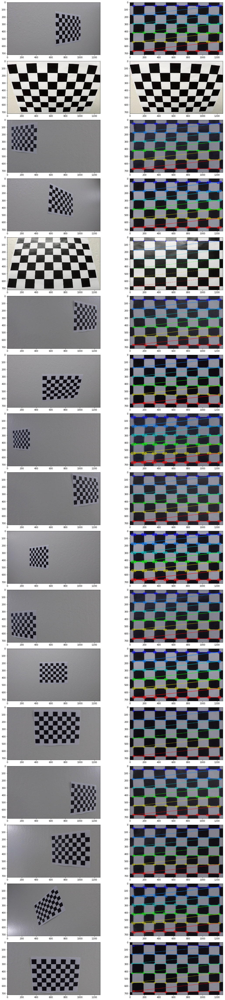

In [4]:
mtx, dist, original_imgs = camera_calibration()

fig, axes = plt.subplots(len(original_imgs), 2, figsize=(15, 70))
fig.tight_layout()
for idx in range(len(original_imgs)):
#     undist = undistort(original_imgs[idx], mtx, dist, draw_chessboard_corners=True)
    undist_warped, _ = corners_unwarp(original_imgs[idx], 9, 6, mtx, dist)
    
    axes[idx, 0].imshow(original_imgs[idx])
#     axes[idx, 0].set_title('Original Image', fontsize=50)
#     axes[idx, 1].imshow(undist)
    axes[idx, 1].imshow(undist_warped)
#     axes[idx, 1].set_title('Undistorted Image', fontsize=50)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

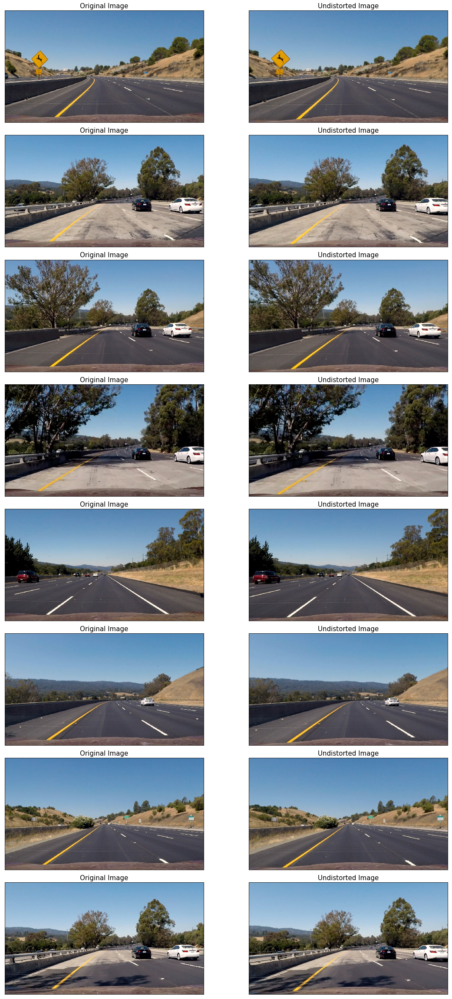

In [5]:
test_imgs = []
undist_test_imgs = []
for fname in glob.glob('./test_images/*.jpg'):
    img = mpimg.imread(fname)
    undist_img = undistort(img, mtx, dist)
    test_imgs.append(img)
    undist_test_imgs.append(undist_img)
    
fig, axes = plt.subplots(len(test_imgs), 2, figsize=(15, 35))
fig.tight_layout()
for idx in range(len(test_imgs)):
    axes[idx, 0].imshow(test_imgs[idx])
    axes[idx, 0].set_title('Original Image', fontsize=15)
    axes[idx, 0].get_xaxis().set_visible(False)
    axes[idx, 0].get_yaxis().set_visible(False)
    axes[idx, 1].imshow(undist_test_imgs[idx])
    axes[idx, 1].set_title('Undistorted Image', fontsize=15)
    axes[idx, 1].get_xaxis().set_visible(False)
    axes[idx, 1].get_yaxis().set_visible(False)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

In [6]:
undist_imgs_l1 = []
for fname in glob.glob('./video_images/project_video_*.jpg'):
    img = mpimg.imread(fname)
    undist_img = undistort(img, mtx, dist)
    undist_imgs_l1.append(undist_img)
    
undist_imgs_l2 = []
for fname in glob.glob('./video_images/challenge_video_*.jpg'):
    img = mpimg.imread(fname)
    undist_img = undistort(img, mtx, dist)
    undist_imgs_l2.append(undist_img)
    
undist_imgs_l3 = []
for fname in glob.glob('./video_images/harder_challenge_video_*.jpg'):
    img = mpimg.imread(fname)
    undist_img = undistort(img, mtx, dist)
    undist_imgs_l3.append(undist_img)

## Perspective transform

In [7]:
top_y = 500
bottom_y = 720
top_x_left = 400
top_x_right = 880
bottom_x_left = 200
bottom_x_right = 1080

def get_perspective_matrix(image):
    src = np.float32([[bottom_x_left, bottom_y],
                      [top_x_left, top_y],
                      [bottom_x_right, bottom_y],
                      [top_x_right, top_y]])

    dst = np.float32([[300, image.shape[0]],
                      [0, 300],
                      [900, image.shape[0]],
                      [1200, 300]])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    return M, Minv

def perspective_transform(image, M):
    # img = np.copy(image)
    # cv2.line(img, (bottom_x_left, bottom_y), (top_x_left, top_y), (0, 255, 0), 5)
    # cv2.line(img, (bottom_x_right, bottom_y), (top_x_right, top_y), (0, 255, 0), 5)
    # cv2.line(img, (top_x_left, top_y), (top_x_right, top_y), (0, 255, 0), 5)
    warped = cv2.warpPerspective(image, M, dsize=(image.shape[1], image.shape[0]), flags=cv2.INTER_LINEAR)
    return warped

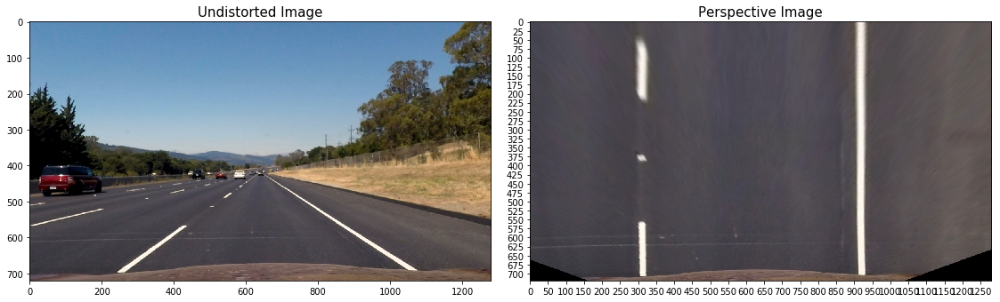

In [8]:
sample_image = mpimg.imread('test_images/straight_lines2.jpg')
undist_img = undistort(sample_image, mtx, dist)
perspective_mat, perspective_mat_inv = get_perspective_matrix(undist_img)
perspective_img = perspective_transform(undist_img, perspective_mat)

fig, axes = plt.subplots(1, 2, figsize=(15, 20))
fig.tight_layout()

idx = 0
axes[0].imshow(undist_img)
axes[0].set_title('Undistorted Image', fontsize=15)
# axes[0].set_xticks(np.arange(0, 1280, 50))
# axes[0].set_yticks(np.arange(0, 720, 50))
axes[1].imshow(perspective_img)
axes[1].set_title('Perspective Image', fontsize=15)
axes[1].set_xticks(np.arange(0, 1280, 50))
axes[1].set_yticks(np.arange(0, 720, 25))

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

In [9]:
# undist_test_imgs
perspective_test_imgs = []
perspective_imgs_l1 = []
perspective_imgs_l2 = []
perspective_imgs_l3 = []
for img in undist_test_imgs:
    perspective_img = perspective_transform(img, perspective_mat)
    perspective_test_imgs.append(perspective_img)
    
for img in undist_imgs_l1:
    perspective_img = perspective_transform(img, perspective_mat)
    perspective_imgs_l1.append(perspective_img)

for img in undist_imgs_l2:
    perspective_img = perspective_transform(img, perspective_mat)
    perspective_imgs_l2.append(perspective_img)
    
for img in undist_imgs_l3:
    perspective_img = perspective_transform(img, perspective_mat)
    perspective_imgs_l3.append(perspective_img)

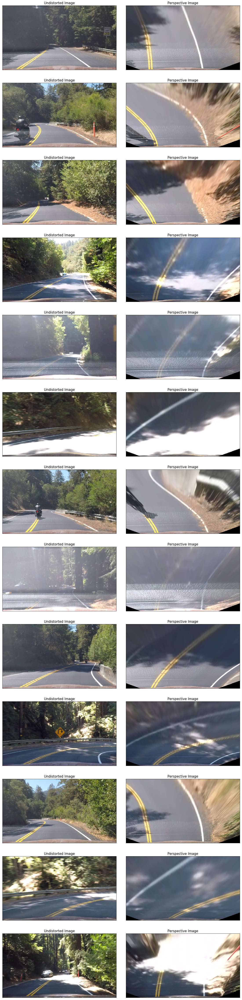

In [10]:
left_images = undist_imgs_l3
right_images = perspective_imgs_l3
fig, axes = plt.subplots(len(left_images), 2, figsize=(15, 70))
fig.tight_layout()
for idx in range(len(left_images)):
    axes[idx, 0].imshow(left_images[idx])
    axes[idx, 0].set_title('Undistorted Image', fontsize=15)
    axes[idx, 0].get_xaxis().set_visible(False)
    axes[idx, 0].get_yaxis().set_visible(False)
    
    axes[idx, 1].imshow(right_images[idx])
    axes[idx, 1].set_title('Perspective Image', fontsize=15)
    axes[idx, 1].get_xaxis().set_visible(False)
    axes[idx, 1].get_yaxis().set_visible(False)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

## Gradient threshold function

In [11]:
def abs_sobel_thresh(image, orient='x', ksize=3, thresh=(0, 255)):
    # Calculate directional gradient
    # Apply threshold
    dx = 1 if orient == 'x' else 0
    dy = 0 if orient == 'x' else 1
    # Apply the following steps to image
    # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobel = cv2.Sobel(gray, cv2.CV_64F, dx, dy, ksize=ksize)
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    # 6) Return this mask as your grad_binary image
    return grad_binary

In [12]:
def mag_threshold(image, ksize=3, thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)
    # 3) Calculate the magnitude 
    mag = np.sqrt(sobel_x**2 + sobel_y**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled = np.uint8(255 * mag / np.max(mag))
    # 5) Create a binary mask where mag thresholds are met
    mag_binary = np.zeros_like(scaled)
    mag_binary[(scaled > thresh[0]) & (scaled < thresh[1])] = 1
    # 6) Return this mask as your mag_binary image
    return mag_binary

## Direction of gradient
[Discuss in Knowledge](https://knowledge.udacity.com/questions/26092)

In [13]:
def dir_threshold(image, ksize=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)
    # 3) Take the absolute value of the x and y gradients
    abs_sobel_x = np.absolute(sobel_x)
    abs_sobel_y = np.absolute(sobel_y)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobel_y, abs_sobel_x)
    # 5) Create a binary mask where direction thresholds are met
    dir_binary = np.zeros_like(direction)
    dir_binary[(direction > thresh[0]) & (direction < thresh[1])] = 1
    # 6) Return this mask as your dir_binary image
    return dir_binary

## Color space threshold function

In [14]:
# A function that thresholds the channel of HLS specified by user
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255), channel='s'):
    # 1) Convert to HLS color space and use color mask
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    mask_yellow = cv2.inRange(hls, np.array([17, 117, 40]), np.array([25, 212, 255]))
    hls = cv2.bitwise_and(hls, hls, mask=mask_yellow)
    # 2) Apply a threshold to the S channel
    channel_img = hls[:,:,2] if channel == 's' else hls[:,:,1]
    # 3) Return a binary image of threshold result
    binary_output = np.zeros_like(channel_img)
    binary_output[(channel_img > thresh[0]) & (channel_img <= thresh[1])] = 1
    return binary_output

In [15]:
def luv_select(img, thresh=(0, 255)):
    luv = cv2.cvtColor(img, cv2.COLOR_RGB2Luv)
    l_channel = luv[:,:,0]
    # 3) Return a binary image of threshold result
    binary_output = np.zeros_like(l_channel)
    binary_output[(l_channel > thresh[0]) & (l_channel <= thresh[1])] = 1
    return binary_output

## Combining color and gradiant threshold

In [16]:
# What we want is keep the lines pixel as much as possible, filter out the other things,
# then save it as a binary image.
def color_gradient_threshold(img):
    # yellow line threshold
    yellow_color = hls_select(img, thresh=(20, 255), channel='s')
    yellow_gradx_binary = abs_sobel_thresh(img, orient='x', ksize=3, thresh=(4, 255))
    
    white_color = luv_select(img, thresh=(185, 255))
    white_gradx_binary = abs_sobel_thresh(img, orient='x', ksize=3, thresh=(10, 255))
    
    mag_thresh = (5, 255) # gradient magnitude threshold
    dir_thresh = (0, np.pi / 4) # gradient direction threshold
    ksize = 3 # gradient kernel size    
    mag_binary = mag_threshold(img, ksize=ksize, thresh=mag_thresh)
    dir_binary = dir_threshold(img, ksize=ksize, thresh=dir_thresh)
    
    # Combine the two binary thresholds
    yellow_binary = np.zeros_like(yellow_color)
    white_binary = np.zeros_like(white_color)
    combined_binary = np.zeros_like(white_color)
    yellow_binary[(yellow_color == 1) & (yellow_gradx_binary == 1) & (dir_binary == 1)] = 1
    white_binary[(white_color == 1) & ((white_gradx_binary == 1) | (mag_binary == 1)) & (dir_binary == 1)] = 1
    combined_binary[(yellow_binary == 1) | (white_binary == 1)] = 1
    
    return combined_binary

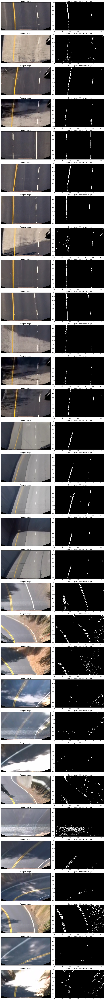

In [18]:
# left_images = perspective_test_imgs
# fig, axes = plt.subplots(len(left_images), 2, figsize=(15, 40))
left_images = perspective_test_imgs + perspective_imgs_l1 + perspective_imgs_l2 + perspective_imgs_l3
fig, axes = plt.subplots(len(left_images), 2, figsize=(15, 160))
fig.tight_layout()
for idx in range(len(left_images)):
    threshold_img = color_gradient_threshold(left_images[idx])
    axes[idx, 0].imshow(left_images[idx])
    axes[idx, 0].set_title('Warped Image', fontsize=15)
    axes[idx, 0].get_xaxis().set_visible(False)
    axes[idx, 0].get_yaxis().set_visible(False)
    # axes[idx, 0].set_xticks(np.arange(0, 1280, 50))
    # axes[idx, 0].set_yticks(np.arange(0, 720, 50))
    axes[idx, 1].imshow(threshold_img, cmap='gray')
    axes[idx, 1].set_title('Color and gradient threshold image', fontsize=15)
    # axes[idx, 1].get_xaxis().set_visible(False)
    # axes[idx, 1].get_yaxis().set_visible(False)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

## Sliding window

In [19]:
# This is the original code copied from class, only use it for showing screenshot.
def find_lane_pixels_old(binary_warped, leftx_base=None, rightx_base=None, draw_window=True):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0] // 2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] // 2)
    leftx_base = leftx_base if leftx_base != None else np.argmax(histogram[:midpoint])
    rightx_base = rightx_base if rightx_base != None else np.argmax(histogram[midpoint:]) + midpoint
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0] // nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        # Find the four below boundaries of the window
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        if draw_window:
            cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 2)
            cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 2)
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window 
        # (`right` or `leftx_current`) on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

In [20]:
# This is the original code copied from class, only use it for showing screenshot.
def fit_polynomial_old(binary_warped, leftx_base=None, rightx_base=None, draw_window=True):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels_old(binary_warped, leftx_base, rightx_base, draw_window)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
        right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1 * ploty**2 + 1 * ploty
        right_fitx = 1 * ploty**2 + 1 * ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')

    return left_fitx, right_fitx, ploty, out_img

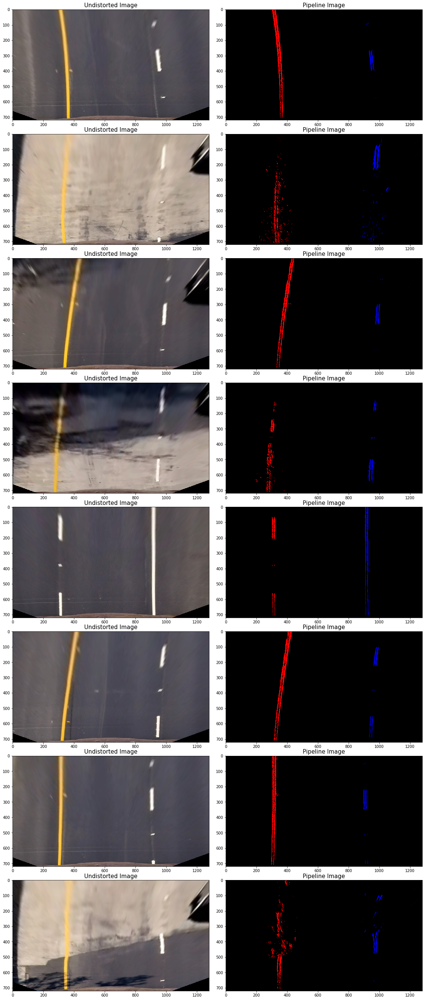

In [21]:
# Test sliding window
# left_images = perspective_imgs_l2 + perspective_imgs_l3
# fig, axes = plt.subplots(len(left_images), 2, figsize=(15, 90))
left_images = perspective_test_imgs
# left_images = perspective_imgs_l1
fig, axes = plt.subplots(len(left_images), 2, figsize=(15, 40))

fig.tight_layout()
for idx in range(len(left_images)):
    binary_warped = color_gradient_threshold(left_images[idx])
    left_fitx, right_fitx, ploty, out_img = fit_polynomial_old(binary_warped, None, None, False)
    axes[idx, 0].imshow(left_images[idx])
    axes[idx, 0].set_title('Undistorted Image', fontsize=15)
#     axes[idx, 0].get_xaxis().set_visible(False)
#     axes[idx, 0].get_yaxis().set_visible(False)
    axes[idx, 1].imshow(out_img)
    axes[idx, 1].set_title('Pipeline Image', fontsize=15)
#     axes[idx, 1].plot(left_fitx, ploty, color='yellow')
#     axes[idx, 1].plot(right_fitx, ploty, color='yellow')
#     axes[idx, 1].get_xaxis().set_visible(False)
#     axes[idx, 1].get_yaxis().set_visible(False)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
plt.close(fig)

In [19]:
def fit_poly(img_shape, line_x, line_y):
    # Fit a second order polynomial to each with np.polyfit()
    poly_fit = np.polyfit(line_y, line_x, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0] - 1, img_shape[0])
    # Calc both polynomials using ploty, left_fit and right_fit
    fit_x = poly_fit[0] * ploty**2 + poly_fit[1] * ploty + poly_fit[2]
    
    return fit_x, ploty, poly_fit

In [20]:
# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

class Window():
    def __init__(self):
        self.x_low = None
        self.x_high = None
        self.y_low = None
        self.y_high = None
        self.allx = None
        self.ally = None

In [21]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # The number of the last records we save
        self.record_size = 10
        # was the line detected in the last iteration?
        self.detected = False
        # x values of the last n fits of the line
        self.recent_xfitted = []
        # average x values of the fitted line over the last n iterations
        self.bestx = None
        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        # polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        # radius of curvature of the line in some units
        self.radius_of_curvature = None
        # distance in meters of vehicle center from the line
        self.line_base_pos = None
        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        # x values for detected line pixels
        self.allx = None
        # y values for detected line pixels
        self.ally = None
        # search windows, for drawing
        self.windows = None
        # Define conversions in x and y from pixels space to meters
        self.ym_per_pix = 3 / 180 # meters per pixel in y dimension
        self.xm_per_pix = 3.7 / 610 # meters per pixel in x dimension
        
    def update(self, windows):
        allx = None
        ally = None
        empty_counter = 0
        line_counter = 0
        new_line = False
        closest_line_idx = -1
        for idx in range(len(windows)):
            win = windows[idx]
            if win.allx.shape[0] == 0:
                empty_counter += 1
                new_line = False
            else:
                if closest_line_idx == -1:
                    closest_line_idx = idx
                if new_line == False:
                    new_line = True
                    line_counter += 1
            if allx == None:
                allx, ally = win.allx, win.ally
            else:
                allx = np.concatenate((allx, win.allx))
                ally = np.concatenate((ally, win.ally))
        best_weight = empty_counter / len(windows)
        # print('empty_counter: {}, new_line: {}'.format(empty_counter, new_line))
        update_best_fit = False if (empty_counter >= 6 and new_line < 2) else True
        # if update_best_fit == False:
        #    print('Skip best fit update')

        if empty_counter == len(windows) or closest_line_idx > nwindows // 3:
            self.detected = False
            self.best_fit = None
        else:
            self.detected = True
        
        # Update best_fit
        if self.detected:
            self.allx, self.ally = allx, ally
            self.radius_of_curvature = self.measure_curvature_real(allx, ally)
            self.windows = windows
            self.current_fit = np.polyfit(ally, allx, 2)
            if self.best_fit == None:
                self.best_fit = self.current_fit
            if update_best_fit:
                curr_fit = self.current_fit.reshape((1, 3))
                best_fit = self.best_fit.reshape((1, 3))
                self.best_fit = np.average(np.concatenate(
                    (curr_fit, best_fit), axis=0), axis=0, weights=[1.0 - best_weight, best_weight])

    def measure_curvature_real(self, plotx, ploty, y_eval=None):
        '''
        Calculates the curvature of polynomial functions in meters.
        '''
        # Compute the polynomial in real world
        fit_cr = np.polyfit(ploty * self.ym_per_pix,
                            plotx * self.xm_per_pix, 2)

        # Define y-value where we want radius of curvature
        # We'll choose the maximum y-value, corresponding to the bottom of the image
        y_eval = np.max(ploty) if y_eval == None else y_eval

        # Compute the radius of curvature
        curverad = (1 + (2 * fit_cr[0] * y_eval * self.ym_per_pix
                         + fit_cr[1])**2)**1.5 / np.absolute(2 * fit_cr[0])

        return curverad
    
left_line = Line()
right_line = Line()

In [22]:
def find_lane_pixels(binary_warped, left_line, right_line):

    def get_histogram(binary_img, y_low, y_high=None):
        if y_high == None:
            return np.sum(binary_img[y_low:, :], axis=0)
        else:
            return np.sum(binary_img[y_low:y_high, :], axis=0)

    def get_window_x_center(line, ploty):
        poly_fit = line.current_fit
        poly_fit = line.best_fit
        fit_x = poly_fit[0] * ploty**2 + poly_fit[1] * ploty + poly_fit[2]
        x_center = np.int(np.mean(fit_x))
        return x_center

    # Take a histogram of the bottom half of the image
    # histogram = np.sum(binary_warped[binary_warped.shape[0] // 2:,:], axis=0)
    histogram = get_histogram(binary_warped, binary_warped.shape[0] // 2)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] // 2)

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0] // nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated later for each window in nwindows
    left_x_center = np.argmax(
        histogram[:midpoint]) if left_line.detected == False else None
    right_x_center = (np.argmax(
        histogram[midpoint:]) + midpoint) if right_line.detected == False else None

    # Create empty lists to receive left and right lane pixel indices
    # left_lane_inds = []
    # right_lane_inds = []
    l_windows = []
    r_windows = []
    # empty_threshold = margin * window_height // 10
    empty_threshold = 10
    continuous_threshold = nwindows // 2 - 1
    l_continuous_empty = 0
    r_continuous_empty = 0

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        # Compute left_x_center and right_x_center
        ploty = np.linspace(win_y_low, win_y_high, window_height)
        if left_line.detected == True:
            if l_continuous_empty >= continuous_threshold:
                histogram = get_histogram(binary_warped, 0, win_y_high)
                max_value = np.max(histogram[:midpoint])
                if max_value > 0:
                    left_x_center = np.argmax(histogram[:midpoint])
            else:
                left_x_center = get_window_x_center(left_line, ploty)
        
        if right_line.detected == True:
            if r_continuous_empty >= continuous_threshold:
                histogram = get_histogram(binary_warped, 0, win_y_high)
                max_value = np.max(histogram[midpoint:])
                if max_value > 0:
                    right_x_center = np.argmax(histogram[midpoint:]) + midpoint
            else:
                right_x_center = get_window_x_center(right_line, ploty)
        # Find the four below boundaries of the window
        l_win = Window()
        r_win = Window()
        # Set left/right window boundary
        l_win.y_low = win_y_low
        l_win.y_high = win_y_high
        l_win.x_low = left_x_center - margin
        l_win.x_high = left_x_center + margin
        r_win.y_low = win_y_low
        r_win.y_high = win_y_high
        r_win.x_low = right_x_center - margin
        r_win.x_high = right_x_center + margin

        # Identify the nonzero pixels in x and y within the window
        left_good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                          & (nonzerox >= l_win.x_low) & (nonzerox < l_win.x_high)).nonzero()[0]
        right_good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                           & (nonzerox >= r_win.x_low) & (nonzerox < r_win.x_high)).nonzero()[0]

        # Monitor the counter of continuous empty sliding window
        # TODO: I want to some verification here
        if left_good_inds.shape[0] < empty_threshold:
            l_continuous_empty += 1
        else:
            l_continuous_empty = 0
        if right_good_inds.shape[0] < empty_threshold:
            r_continuous_empty += 1
        else:
            r_continuous_empty = 0

        left_x = nonzerox[left_good_inds]
        left_y = nonzeroy[left_good_inds]
        right_x = nonzerox[right_good_inds]
        right_y = nonzeroy[right_good_inds]
        l_win.allx = left_x
        l_win.ally = left_y
        r_win.allx = right_x
        r_win.ally = right_y

        # If you found > minpix pixels, recenter next window
        # (`right` or `leftx_current`) on their mean position
        if len(left_good_inds) > minpix and left_line.detected == False:
            left_x_center = np.int(np.mean(nonzerox[left_good_inds]))
        if len(right_good_inds) > minpix and right_line.detected == False:
            right_x_center = np.int(np.mean(nonzerox[right_good_inds]))

        l_windows.append(l_win)
        r_windows.append(r_win)
    return l_windows, r_windows

## Measure curvature

![Curvature](https://video.udacity-data.com/topher/2016/December/58449a23_color-fit-lines/color-fit-lines.jpg)


## $$ R_{curve} = \frac{[1+(\frac{dx}{dy})^2]^{3/2}}{\left | \frac{d^2x}{dy} \right |} = \frac{[1+(2Ay+B)^2]^{3/2}}{\left | 2A \right |} $$

In [23]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [25]:
def draw_lane_pixel(binary_warped, left_line, right_line, ploty):
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    out_img[left_line.ally, left_line.allx] = [255, 0, 0]
    out_img[right_line.ally, right_line.allx] = [0, 0, 255]

    # Draw best fit
    l_best_fitx = left_line.best_fit[0] * ploty**2 + \
        left_line.best_fit[1] * ploty + left_line.best_fit[2]
    r_best_fitx = right_line.best_fit[0] * ploty**2 + \
        right_line.best_fit[1] * ploty + right_line.best_fit[2]
    for x1, x2, y in zip(l_best_fitx, r_best_fitx, ploty):
        # yellow
        cv2.circle(out_img, (int(x1), int(y)), 2, (252, 246, 66), -1)
        cv2.circle(out_img, (int(x2), int(y)), 2, (252, 246, 66), -1)
    # Draw current fit
    l_curr_fitx = left_line.current_fit[0] * ploty**2 + \
        left_line.current_fit[1] * ploty + left_line.current_fit[2]
    r_curr_fitx = right_line.current_fit[0] * ploty**2 + \
        right_line.current_fit[1] * ploty + right_line.current_fit[2]
    for x1, x2, y in zip(l_curr_fitx, r_curr_fitx, ploty):
        # purple
        cv2.circle(out_img, (int(x1), int(y)), 2, (217, 48, 214), -1)
        cv2.circle(out_img, (int(x2), int(y)), 2, (217, 48, 214), -1)
    # Draw windows
    for win in left_line.windows:
        info = '{}'.format(win.allx.shape[0])
        cv2.putText(out_img, info, (win.x_high + 1, (win.y_low + win.y_high)
                                    // 2 + 15), cv2.FONT_HERSHEY_TRIPLEX, 2, (255, 255, 255), 4, cv2.LINE_AA)
        cv2.rectangle(out_img, (win.x_low, win.y_high),
                      (win.x_high, win.y_low), (0, 255, 0), 2)
    for win in right_line.windows:
        info = '{}'.format(win.allx.shape[0])
        cv2.putText(out_img, info, (win.x_high + 1, (win.y_low + win.y_high)
                                    // 2 + 15), cv2.FONT_HERSHEY_TRIPLEX, 2, (255, 255, 255), 4, cv2.LINE_AA)
        cv2.rectangle(out_img, (win.x_low, win.y_high),
                      (win.x_high, win.y_low), (0, 255, 0), 2)
    cv2.rectangle(
        out_img, (0, 0), (binary_warped.shape[1], binary_warped.shape[0]), (0, 255, 0), 5)
    return out_img

In [33]:
def sanity_checking(image, left_line, right_line):
    def get_fit_x(poly_fit, ploty):
        return poly_fit[0] * ploty**2 + poly_fit[1] * ploty + [2]

    def check_range(image, x):
        return x >= 0 and x < image.shape[1]

    def check_outlier(data):
        outlier_constant = 1.5
        upper_quartile = np.percentile(data, 75)
        lower_quartile = np.percentile(data, 25)
        iqr = (upper_quartile - lower_quartile) * outlier_constant
        upper_bound = upper_quartile + iqr
        lower_bound = lower_quartile - iqr
        outlier = data[(data < lower_bound) | (data > upper_bound)]
        return outlier.shape[0] > 0
    
    if left_line.detected == False or right_line.detected == False:
        return False

    ploty = np.linspace(0, image.shape[0] - 1, image.shape[0])
    left_fitx = get_fit_x(left_line.best_fit, ploty)
    right_fitx = get_fit_x(right_line.best_fit, ploty)

    check_point = 10
    check_ploty = np.linspace(0, image.shape[0] - 1, check_point)
    check_left_fitx = get_fit_x(left_line.best_fit, check_ploty)
    check_right_fitx = get_fit_x(right_line.best_fit, check_ploty)
    x_distance = check_right_fitx - check_left_fitx
    min_dis = np.min(x_distance)
    max_dis = np.max(x_distance)

    left_radius = left_line.measure_curvature_real(
        left_fitx, ploty, y_eval=check_ploty)
    right_radius = right_line.measure_curvature_real(
        right_fitx, ploty, y_eval=check_ploty)

    y_top_idx = None
    y_bottom_idx = None
    result = True
    for idx in range(len(check_ploty)):
        if check_range(image, check_left_fitx[idx]) and check_range(image, check_right_fitx[idx]):
            y_top_idx = idx
            break
    for idx in range(len(check_ploty) - 1, -1, -1):
        if check_range(image, check_left_fitx[idx]) and check_range(image, check_right_fitx[idx]):
            y_bottom_idx = idx
            break
    # TODO: Checking that they have similar curvature
    # TODO: Checking that they are separated by approximately the right distance horizontally

    # Check if there is a cross between left line and right line
    for idx in range(y_top_idx, y_bottom_idx + 1, 1):

        if x_distance[idx] < 0:
            result = False
            break
    # Checking that they are roughly parallel
    if result == True and check_outlier(x_distance):
        result = False
    if result == False:
        left_line.detected = False
        left_line.best_fit = None
        right_line.detected = False
        right_line.best_fit = None
    return result

In [26]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # you should return the final output (image where lines are drawn on lanes)

    undist_img = undistort(image, mtx, dist)
    perspective_img = perspective_transform(undist_img, perspective_mat)
    binary_warped = color_gradient_threshold(perspective_img)

    l_windows, r_windows = find_lane_pixels(binary_warped, left_line, right_line)
    left_line.update(l_windows)
    right_line.update(r_windows)
    
    if left_line.detected and right_line.detected:
        def get_center_shift(left_x, middle_x, xm_per_pix, real_road_width):
            curr_left_dis = (middle_x - left_x) * xm_per_pix
            return (real_road_width / 2) - curr_left_dis
        
        # Generate x and y values for plotting
        ploty = np.linspace(0, image.shape[0] - 1, image.shape[0])
        # Calc both polynomials using ploty, left_fit and right_fit
        left_fitx = left_line.best_fit[0] * ploty**2 + \
            left_line.best_fit[1] * ploty + left_line.best_fit[2]
        right_fitx = right_line.best_fit[0] * ploty**2 + \
            right_line.best_fit[1] * ploty + right_line.best_fit[2]

        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array(
            [np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(
            color_warp, perspective_mat_inv, (image.shape[1], image.shape[0]))
        # Combine the result with the original image
        result = cv2.addWeighted(undist_img, 1, newwarp, 0.3, 0)

        # Show text information
        shift = get_center_shift(left_fitx[-1], image.shape[1] // 2, left_line.xm_per_pix, 3.7)
        info1 = 'L radius: {:>8.3f}m'.format(left_line.radius_of_curvature)
        info2 = 'R radius: {:>8.3f}m'.format(right_line.radius_of_curvature)
        info3 = 'Vehicle is {:>4.2f}m {} of center'.format(
            abs(shift), 'left' if shift >= 0 else 'right')
        cv2.putText(result, info1, (30, 30), cv2.FONT_HERSHEY_PLAIN,
                    2, (0, 255, 255), 2, cv2.LINE_AA)
        cv2.putText(result, info2, (30, 60), cv2.FONT_HERSHEY_PLAIN,
                    2, (0, 255, 255), 2, cv2.LINE_AA)
        cv2.putText(result, info3, (30, 90), cv2.FONT_HERSHEY_PLAIN,
                    2, (0, 255, 255), 2, cv2.LINE_AA)

        color_warped = np.dstack(
            (binary_warped, binary_warped, binary_warped)) * 255
        empty_img = np.dstack((np.zeros_like(binary_warped), np.zeros_like(
            binary_warped), np.zeros_like(binary_warped)))
        lane_color_img = draw_lane_pixel(
            binary_warped, left_line, right_line, ploty)
        top_img = cv2.hconcat(
            [perspective_img, color_warped, lane_color_img, empty_img])
        top_img = cv2.resize(
            top_img, (image.shape[1], 180), interpolation=cv2.INTER_LINEAR)
        final_image = np.zeros(
            (result.shape[0] + top_img.shape[0], result.shape[1], 3), dtype=np.uint8)
        final_image[:top_img.shape[0]] = top_img
        final_image[top_img.shape[0]:] = result
        return final_image
    else:
        info = 'Fail to detect lane line'
        cv2.putText(image, info, (30, 30), cv2.FONT_HERSHEY_PLAIN,
                    2, (0, 255, 255), 1, cv2.LINE_AA)
        color_warped = np.dstack(
            (binary_warped, binary_warped, binary_warped)) * 255
        empty_img = np.dstack((np.zeros_like(binary_warped), np.zeros_like(
            binary_warped), np.zeros_like(binary_warped)))
        top_img = cv2.hconcat(
            [perspective_img, color_warped, empty_img, empty_img])
        top_img = cv2.resize(
            top_img, (image.shape[1], 180), interpolation=cv2.INTER_LINEAR)
        final_image = np.zeros(
            (image.shape[0] + top_img.shape[0], image.shape[1], 3), dtype=np.uint8)
        final_image[:top_img.shape[0]] = top_img
        final_image[top_img.shape[0]:] = image
        return final_image

### For writeup

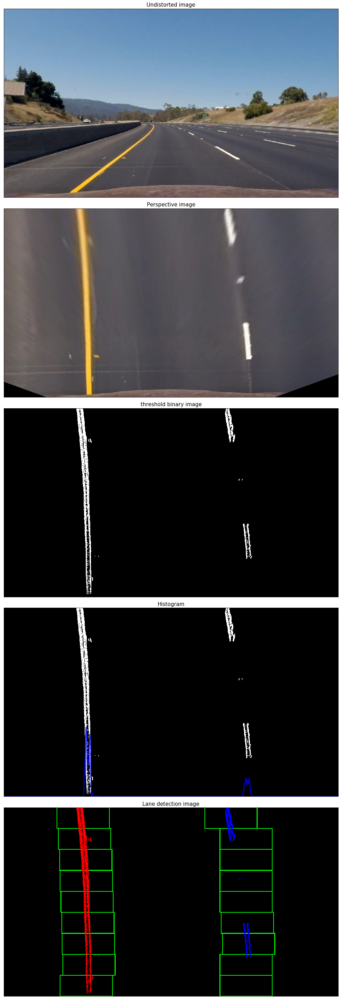

In [40]:
sample_image = mpimg.imread('video_images/project_video_01.jpg')
undist_img = undistort(sample_image, mtx, dist)
perspective_img = perspective_transform(undist_img, perspective_mat)
threshold_img = color_gradient_threshold(perspective_img)
histogram = 719 - np.sum(threshold_img[threshold_img.shape[0] // 2:,:], axis=0)
# print('histogram shape: {}'.format(histogram.shape))
his_x = np.arange(0, threshold_img.shape[1], 1)
left_fitx, right_fitx, ploty, out_img = fit_polynomial_old(threshold_img, None, None, True)
    
fig, axes = plt.subplots(5, 1, figsize=(15, 40))
fig.tight_layout()

axes[0].imshow(undist_img)
axes[0].set_title('Undistorted image', fontsize=15)
axes[0].get_xaxis().set_visible(False)
axes[0].get_yaxis().set_visible(False)

axes[1].imshow(perspective_img)
axes[1].set_title('Perspective image', fontsize=15)
axes[1].get_xaxis().set_visible(False)
axes[1].get_yaxis().set_visible(False)

axes[2].imshow(threshold_img, cmap='gray')
axes[2].set_title('threshold binary image', fontsize=15)
axes[2].get_xaxis().set_visible(False)
axes[2].get_yaxis().set_visible(False)

axes[3].imshow(threshold_img, cmap='gray')
axes[3].set_title('Histogram', fontsize=15)
axes[3].get_xaxis().set_visible(False)
axes[3].get_yaxis().set_visible(False)
line, = axes[3].plot(his_x, histogram, color='blue', alpha=0.8, lw=3)

axes[4].imshow(out_img)
axes[4].set_title('Lane detection image', fontsize=15)
axes[4].get_xaxis().set_visible(False)
axes[4].get_yaxis().set_visible(False)
plt.savefig('process.png')
plt.show()
plt.close(fig)

In [27]:
video_name = "project_video.mp4"
# video_name = 'challenge_video.mp4'
# video_name = 'harder_challenge_video.mp4'
white_output = "output_videos/" + video_name
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
# clip1 = VideoFileClip(video_name).set_fps(1).subclip(0, 3)
# clip1 = VideoFileClip(video_name).set_fps(1)
# clip1 = VideoFileClip(video_name).subclip(35, 40)
# clip1 = VideoFileClip(video_name).subclip(0, 5)
clip1 = VideoFileClip(video_name)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video output_videos/project_video.mp4
[MoviePy] Writing video output_videos/project_video.mp4


100%|█████████▉| 1260/1261 [08:49<00:00,  3.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/project_video.mp4 

CPU times: user 4min 25s, sys: 2.78 s, total: 4min 28s
Wall time: 8min 52s


In [48]:
video_name_1 = "output_videos/project_video.mp4"
video_name_2 = "output_videos/challenge_video.mp4"
# video_name = 'challenge_video.mp4'
# video_name = 'harder_challenge_video.mp4'
clip1 = VideoFileClip(video_name_1)
clip2 = VideoFileClip(video_name_2)
# white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
# %time white_clip.write_videofile(white_output, audio=False)

gif_clip_1 = clip1.subclip(20, 25)
gif_clip_2 = clip2.subclip(0, 4)
gif_clip_1.speedx(2).to_gif('output_videos/project_video_20_25.gif')
gif_clip_2.speedx(2).to_gif('output_videos/challenge_video_00_04.gif')


[MoviePy] Building file output_videos/project_video_20_25.gif with imageio


100%|██████████| 63/63 [00:27<00:00,  2.49it/s]


[MoviePy] Building file output_videos/challenge_video_00_04.gif with imageio



100%|██████████| 60/60 [00:22<00:00,  2.58it/s]


In [82]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

In [28]:
# video_name = "project_video.mp4"
video_name = 'challenge_video.mp4'
# video_name = 'harder_challenge_video.mp4'
white_output = "output_videos/" + video_name
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
# clip1 = VideoFileClip(video_name).set_fps(1).subclip(0, 3)
# clip1 = VideoFileClip(video_name).set_fps(1)
# clip1 = VideoFileClip(video_name).subclip(0, 5)
clip1 = VideoFileClip(video_name)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video output_videos/challenge_video.mp4
[MoviePy] Writing video output_videos/challenge_video.mp4


100%|██████████| 485/485 [02:33<00:00,  3.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/challenge_video.mp4 

CPU times: user 1min 39s, sys: 1.28 s, total: 1min 40s
Wall time: 2min 36s


In [57]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

In [49]:
# video_name = "project_video.mp4"
# video_name = 'challenge_video.mp4'
video_name = 'harder_challenge_video.mp4'
white_output = "output_videos/" + video_name
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
# clip1 = VideoFileClip(video_name).set_fps(1).subclip(0, 3)
# clip1 = VideoFileClip(video_name).set_fps(1)
# clip1 = VideoFileClip(video_name).subclip(0, 5)
clip1 = VideoFileClip(video_name)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video output_videos/harder_challenge_video.mp4
[MoviePy] Writing video output_videos/harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [07:05<00:00,  2.88it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/harder_challenge_video.mp4 

CPU times: user 4min 3s, sys: 4.31 s, total: 4min 7s
Wall time: 7min 10s
